<a href="https://colab.research.google.com/github/shivakerur99/Image-pro/blob/master/cyberrealstic.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install diffusers
!pip install xformers

vae/diffusion_pytorch_model.safetensors not found


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


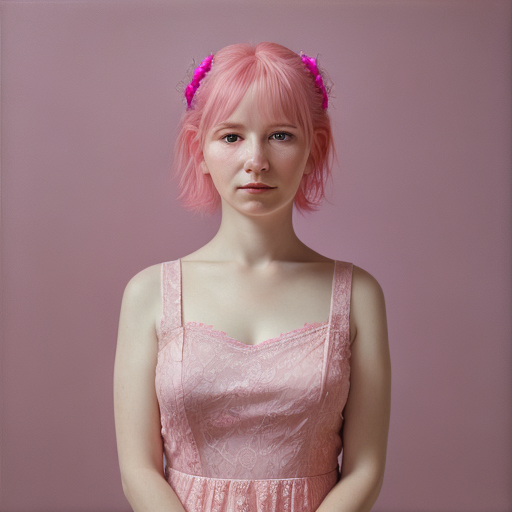

Upscaled image:


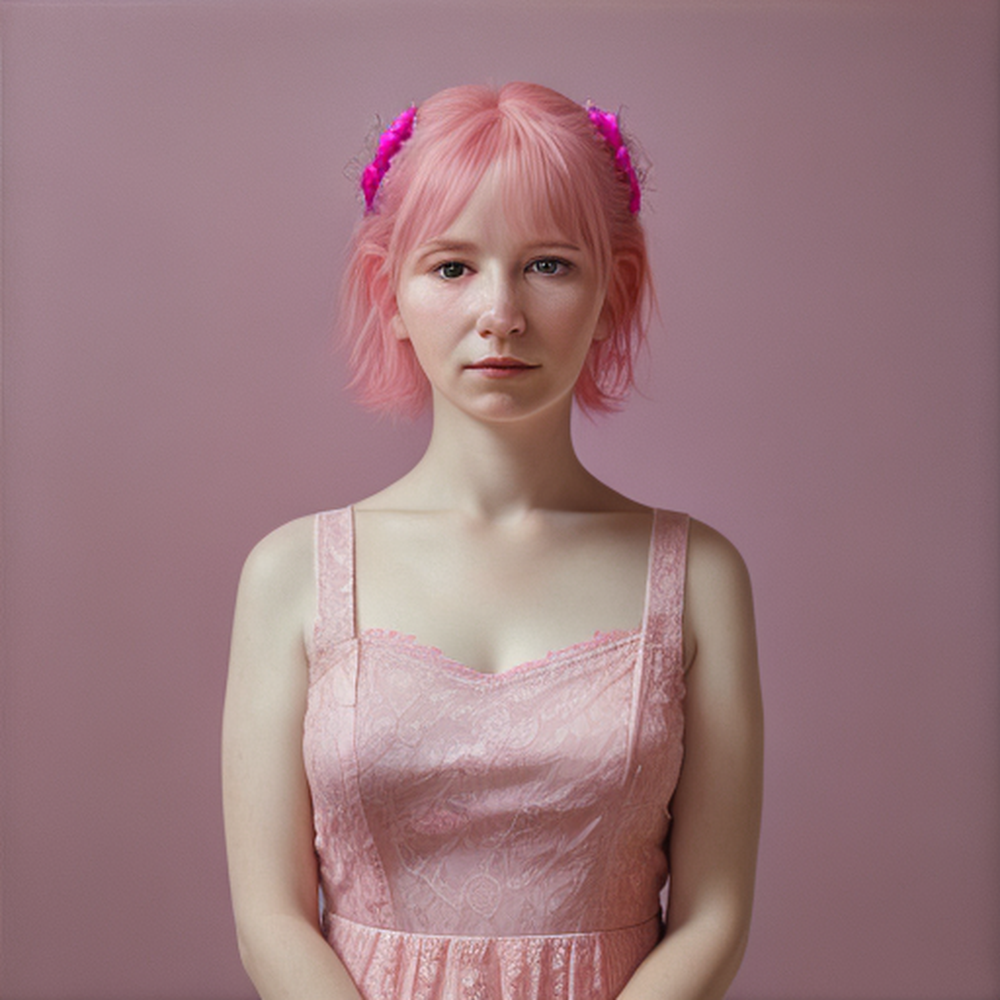

In [ ]:
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler
from PIL import Image
import requests
from io import BytesIO
from IPython.display import display

# Initialize Stable Diffusion Pipeline
model_id = "stablediffusionapi/cyberrealistic"
pipe = StableDiffusionPipeline.from_pretrained(model_id, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)
pipe.enable_xformers_memory_efficient_attention()

# Set the text prompt
prompt = "A woman wearing pink hair in a pink lace dress, in the style of hyperrealism and photorealism, UHD image, soft-focused realism, pastel color, babycore --ar 1:2 --q 2 --s 750"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 512
width = 512

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

you can add photo to your prompt to make your gens look more photorealistic. Non-square aspect ratios work better for some prompts. If you want a portrait photo, try using a vertical aspect ratio. If you want a landscape photo, try using a horizontal aspect ratio. This model was trained on 768x768px images, so use 768x768px, 640x896px, 896x640px, etc. It also works pretty good with higher resolutions such as 768x1024px or 1024x768px.

advantages:

1. better for 512 X 512 base image and processing time is also less and provide efficency of 93%.
2. no distortion present in 512 pixel.
3. able to understand dress based prompts effectively.
**disadvantages or limitations:**

1. less efficency in eyes
2. sometimes cartonistic image generation

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


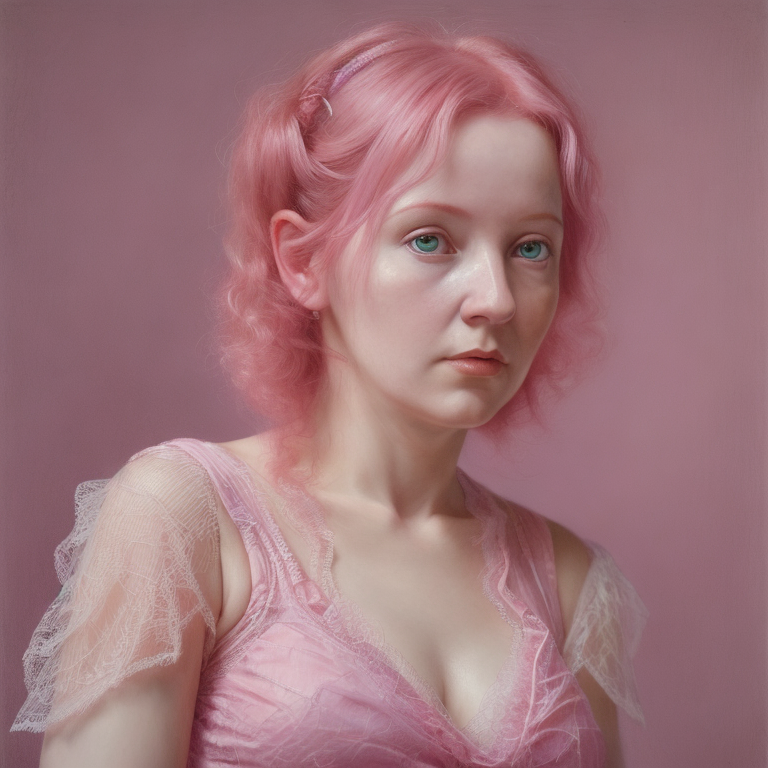

Upscaled image:


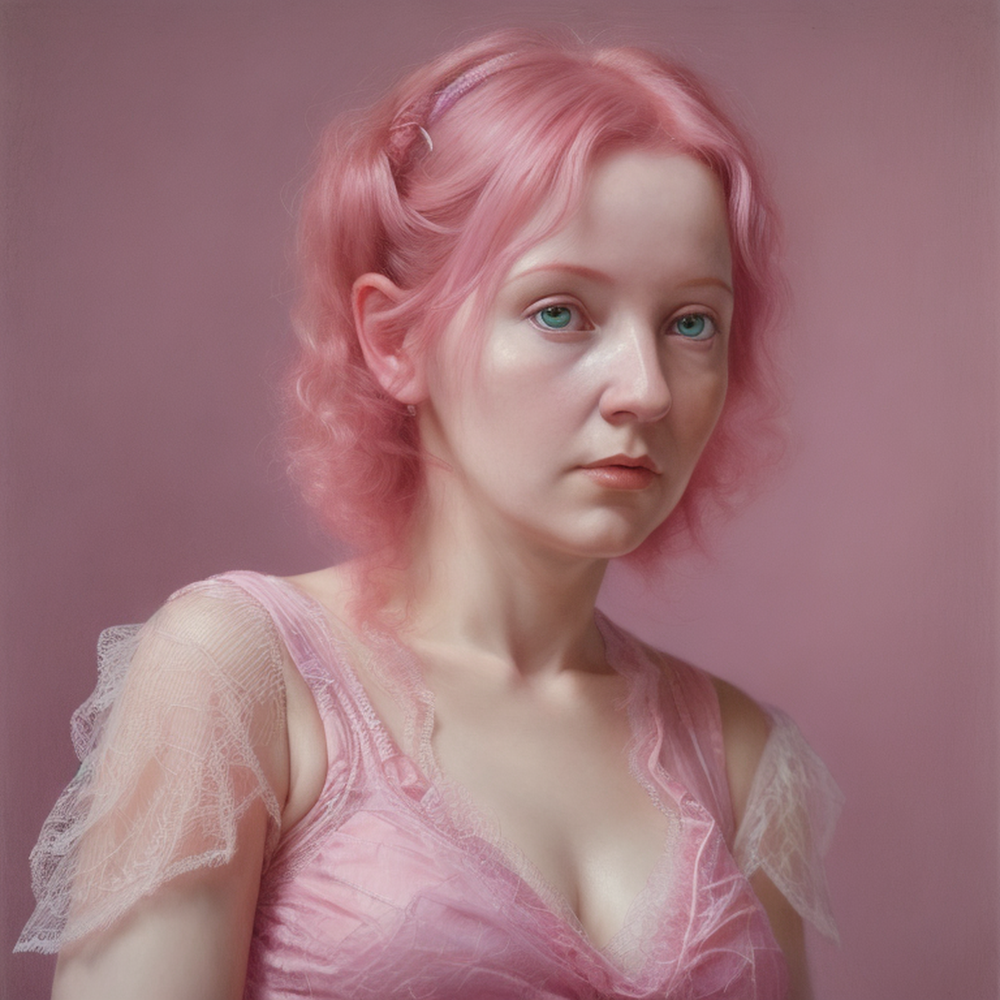

In [ ]:
prompt = "A woman wearing pink hair in a pink lace dress, in the style of hyperrealism and photorealism, UHD image, soft-focused realism, pastel color, babycore --ar 1:2 --q 2 --s 750"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 768
width = 768

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])


you can add photo to your prompt to make your gens look more photorealistic. Non-square aspect ratios work better for some prompts. If you want a portrait photo, try using a vertical aspect ratio. If you want a landscape photo, try using a horizontal aspect ratio. This model was trained on 768x768px images, so use 768x768px etc. It also works pretty good with higher resolution

**advantages:**

1. better for 768 X 768 base image and processing time is also less and provide efficency of 95%.
2. no distortion present in 768 pixel.
3. able to understand dress based prompts effectively.
**disadvantages or limitations:**

1. less efficency in eyes
2. sometimes cartonistic image generation

**LIMITATION EXAMPLES**

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['gaze into the camera, model is expressed in realistic, high contrast, highlighted light effects -- ar 9 : 1 6 -- style raw -- stylize 7 0 0 -- v 6']


  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


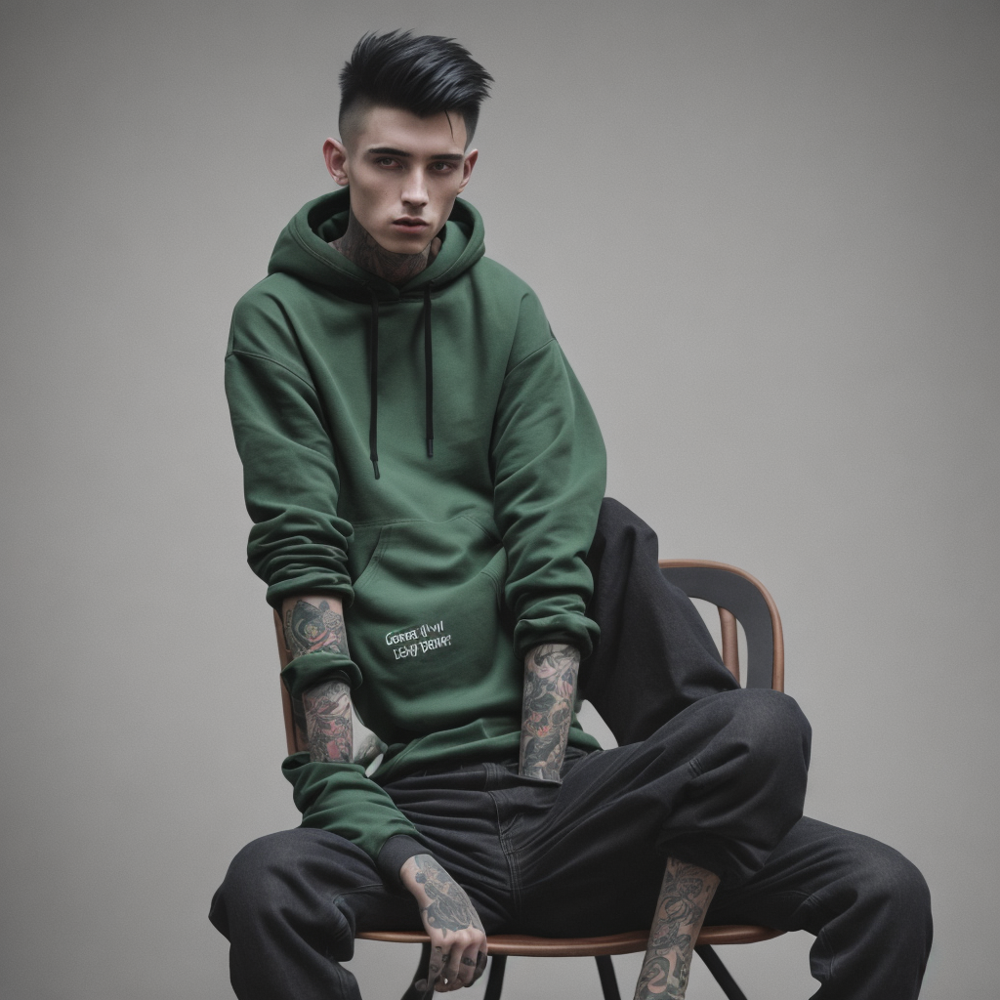

Upscaled image:


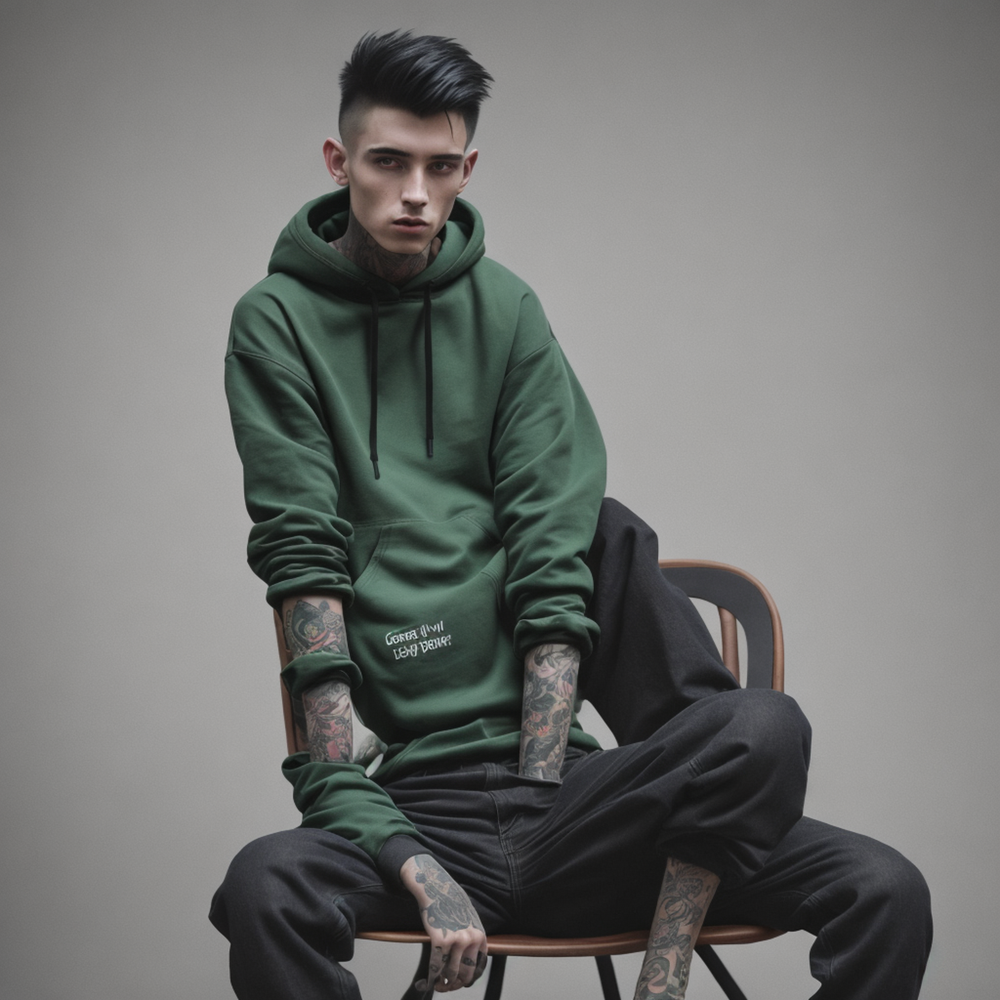

In [ ]:
prompt = "photography, long-distance shot, man model, seated on chair, green long undercut, dark deep forest color loose-fit hoody with gothic lettering tattoo, garment-dyed black denim jogger pants, Sony α9 II with Sony FE 100-400mm f/4. 5-5. 6 GM OSS lens, grey background studio, gaze into the camera, model is expressed in realistic, high contrast, highlighted light effects --ar 9:16 --style raw --stylize 700 --v 6"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 1024
width = 1024

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

**Provide distorted image for greater than 768 pixel**
**multiple person's or multiple body of same person**

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


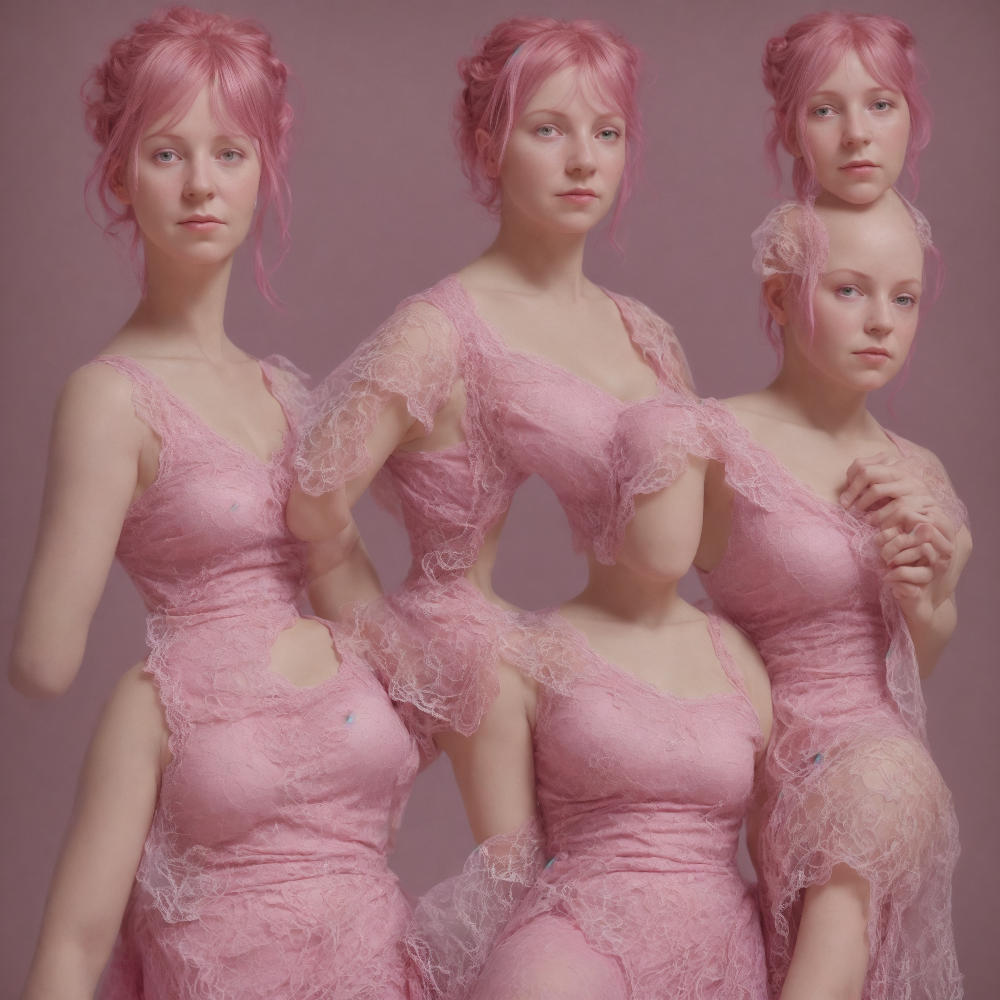

Upscaled image:


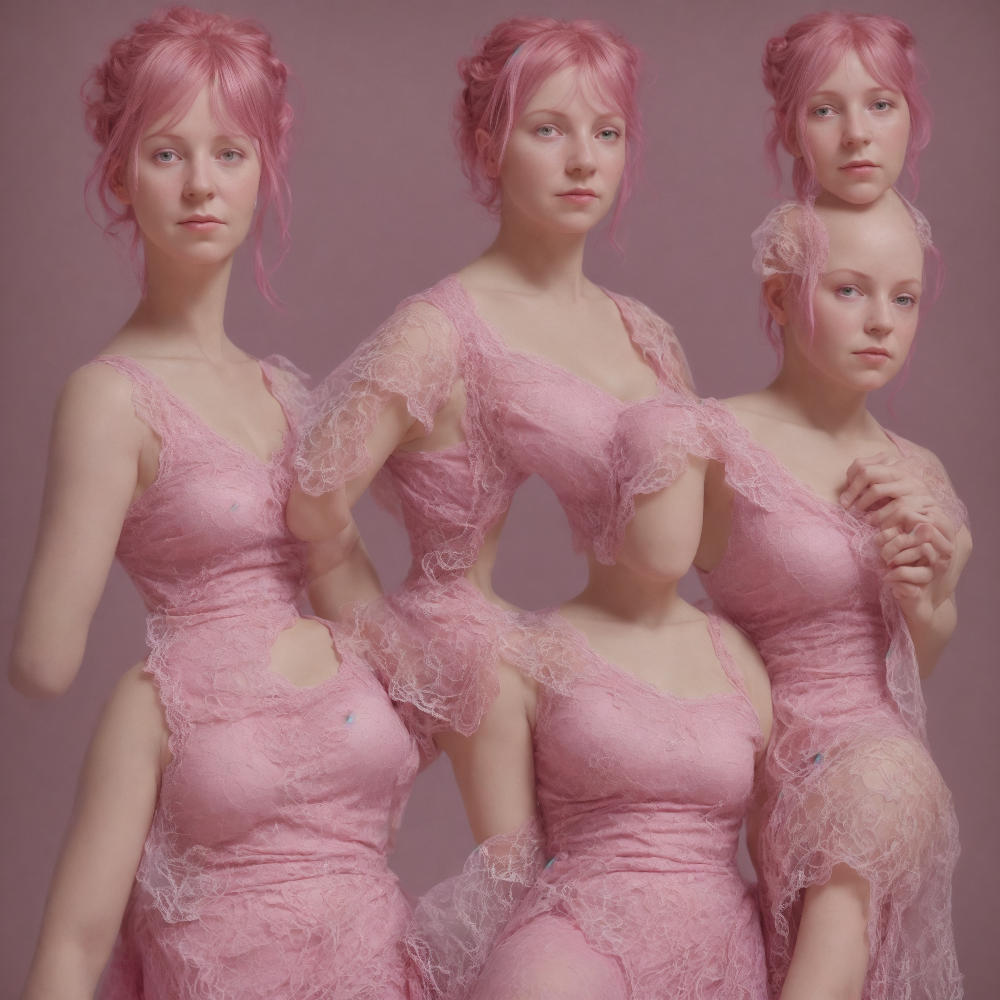

In [ ]:
prompt = "A woman wearing pink hair in a pink lace dress, in the style of hyperrealism and photorealism, UHD image, soft-focused realism, pastel color, babycore --ar 1:2 --q 2 --s 750"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 2048
width = 2048

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

**we can able to create 2048X2048 pixel image through model but image efficiency too low **
**Provide distorted image for greater than 768 pixel**
**multiple person's or multiple body of same person**

**EXAMPLES WITH DIFFERENT PROMPTS**

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


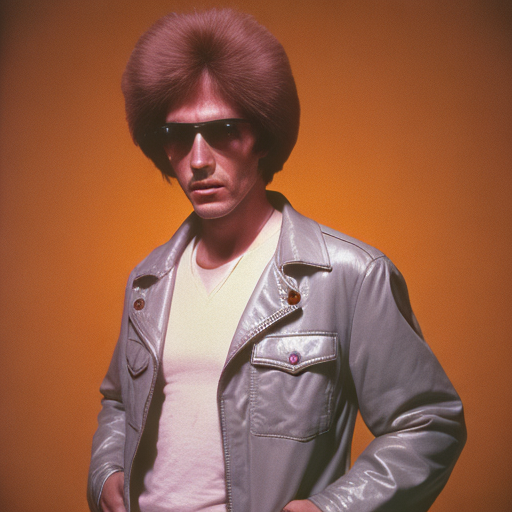

Upscaled image:


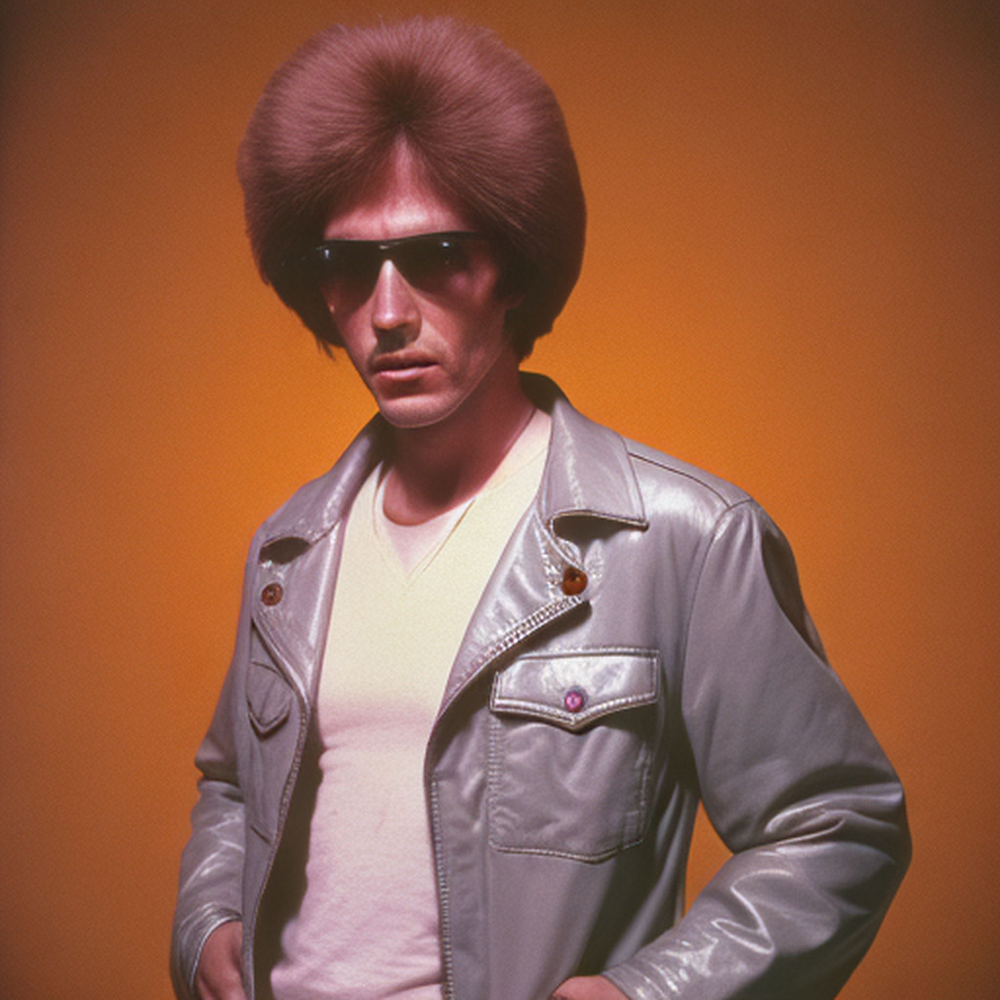

In [ ]:
prompt = "a man with jacket in the style of post-'70s ego generation, photo taken with provia, grandeur of scale, rangercore, full body, ue5, royalcore --v 5. 2 --ar 85:128"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 512
width = 512

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])

  0%|          | 0/24 [00:00<?, ?it/s]

Original generated image:


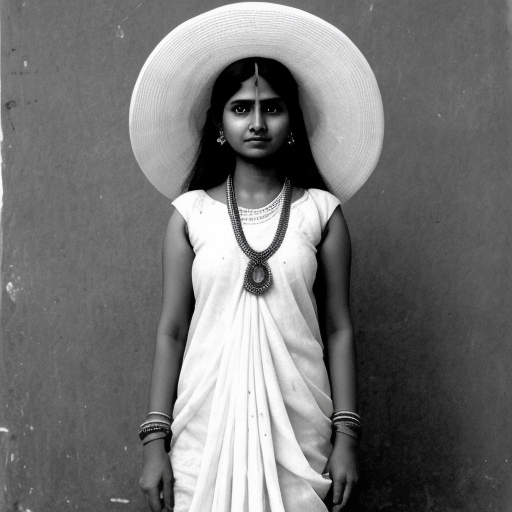

Upscaled image:


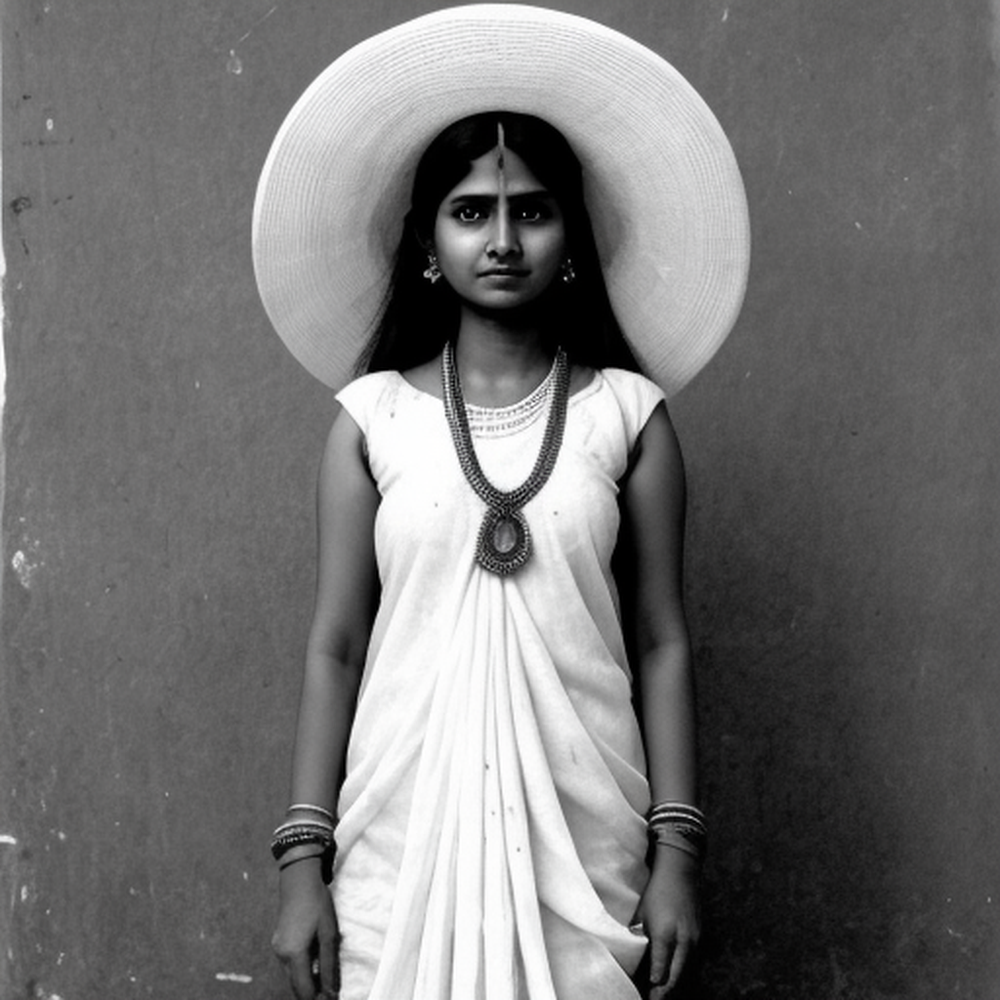

In [ ]:
prompt = "the indian woman ,small clear eyes in white dress posing for a photo, full body, in the style of asymmetrical geometry, hatcore --ar 85:128"
num_samples = 1
guidance_scale = 7.5
num_inference_steps = 24
height = 512
width = 512

# Generate images based on the prompt
with autocast("cuda"), torch.inference_mode():
    images = pipe(
        prompt,
        height=height,
        width=width,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale
    ).images

# Upscale the images to 2048 x 2048 pixels
upscaled_images = []
for img in images:
    upscaled_img = img.resize((2048, 2048), Image.LANCZOS)  # Upscale using Lanczos filter
    upscaled_images.append(upscaled_img)

# Display the original generated image
print("Original generated image:")
display(images[0])

# Display the upscaled image
print("Upscaled image:")
display(upscaled_images[0])